In [2]:
#!/usr/bin/env python
# -*- coding: utf-8 -*-
from __future__ import print_function
import argparse
import os

import numpy as np
import pickle

from keras import backend as K
from keras.callbacks import ModelCheckpoint
from keras.models import Model
from keras.layers import Input
from keras.layers import Conv2D, MaxPooling2D, UpSampling2D, Concatenate, Flatten, Dense, Dropout
from keras.layers import merge
from keras.optimizers import Adam, SGD, RMSprop
from keras.preprocessing.image import list_pictures, array_to_img

from image_ext import list_pictures_in_multidir, load_imgs_asarray
from create_fcn import create_fcn01, create_pupil_net00

np.random.seed(2016)

In [3]:
def load_fnames(paths):
    f = open(paths)
    data1 = f.read()
    f.close()
    lines = data1.split('\n')
    #print(len(lines))
    # 最終行は空行なので消す
    del(lines[len(lines)-1])
    #print(len(lines))
    return lines

In [4]:
def make_fnames(fnames,fpath,fpath_mask,mask_ext):
    fnames_img = [];
    fnames_mask= [];
    
    for i in range(len(fnames)):
        fnames_img.append(fpath + '/' + fnames[i]);
        fnames_mask.append(fpath_mask + '/' + mask_ext + fnames[i]);
        
    return [fnames_img,fnames_mask]

In [5]:
def get_center(im):
    im[im>0] = 1;
    xval = 0
    yval = 0
    npix = 0

    for x in range(0,im.shape[1]):
        xval += (x*sum(im[:,x]))
        npix += sum(im[:,x])
    
    for y in range(0,im.shape[0]):
        yval += (y*sum(im[y,:]))
    
    return [xval/npix,yval/npix]

In [6]:
#
#  MAIN STARTS FROM HERE
#
if __name__ == '__main__':
    
    target_size = (224, 224)
    dpath_this = './'
    dname_checkpoints = 'checkpoints_pupil_net00'
    dname_checkpoints_fcn01 = 'checkpoints_fcn01'
    dname_outputs = 'outputs'
    fname_architecture = 'architecture.json'
    fname_weights = "model_weights_{epoch:02d}.h5"
    fname_stats = 'stats01.npz'
    dim_ordering = 'channels_first'
    fname_history = "history.pkl"

    # definision of mode, LEARN or TEST or SHOW_HISTORY
    mode = "LEARN"
    mode = "SHOW_HISTORY"
    mode = "TEST"

    # モデルを作成
    print('creating model...')
    model_pupil_net = create_pupil_net00(target_size)

creating model...


In [7]:
#
#   LEARNING MODE
#
mode = "LEARN"
if mode == "LEARN":
    # Read Learning Data
    fnames = load_fnames('data/list_train_01.txt')
    [fpaths_xs_train,fpaths_ys_train] = make_fnames(fnames,'data/img','data/mask','OperatorA_')

    X_train = load_imgs_asarray(fpaths_xs_train, grayscale=False, target_size=target_size,
                                dim_ordering=dim_ordering)
    Y_train = load_imgs_asarray(fpaths_ys_train, grayscale=True, target_size=target_size,
                                dim_ordering=dim_ordering) 

    # Read Validation Data
    fnames = load_fnames('data/list_valid_01.txt')
    [fpaths_xs_valid,fpaths_ys_valid] = make_fnames(fnames,'data/img','data/mask','OperatorA_')

    X_valid = load_imgs_asarray(fpaths_xs_valid, grayscale=False, target_size=target_size,
                                dim_ordering=dim_ordering)
    Y_valid = load_imgs_asarray(fpaths_ys_valid, grayscale=True, target_size=target_size,
                                dim_ordering=dim_ordering)     

    # obtain center of pupil
    center_train = []
    center_valid = []
    
    for i in range(Y_train.shape[0]):
        center_train.append(get_center(Y_train[i,0,:,:]))

    for i in range(Y_valid.shape[0]):
        center_valid.append(get_center(Y_valid[i,0,:,:]))
    
    center_train = np.array(center_train)
    center_valid = np.array(center_valid)

    print('==> ' + str(len(X_train)) + ' training images loaded')
    print('==> ' + str(len(Y_train)) + ' training masks loaded')
    print('==> ' + str(len(X_valid)) + ' validation images loaded')
    print('==> ' + str(len(Y_valid)) + ' validation masks loaded')

    # 前処理
    print('computing mean and standard deviation...')
    mean = np.mean(X_train, axis=(0, 2, 3))
    std = np.std(X_train, axis=(0, 2, 3))
    print('==> mean: ' + str(mean))
    print('==> std : ' + str(std))

    print('saving mean and standard deviation to ' + fname_stats + '...')
    stats = {'mean': mean, 'std': std}
    if os.path.exists(dname_checkpoints) == 0:
        os.mkdir(dname_checkpoints)
    np.savez(dname_checkpoints + '/' + fname_stats, **stats)
    print('==> done')

    print('globally normalizing data...')
    for i in range(3):
        X_train[:, i] = (X_train[:, i] - mean[i]) / std[i]
        X_valid[:, i] = (X_valid[:, i] - mean[i]) / std[i]
    Y_train /= 255
    Y_valid /= 255
    print('==> done')

==> 1452 training images loaded
==> 1452 training masks loaded
==> 527 validation images loaded
==> 527 validation masks loaded
computing mean and standard deviation...
==> mean: [130.65465  91.2685   76.63643]
==> std : [55.2817   43.990963 43.113483]
saving mean and standard deviation to stats01.npz...
==> done
globally normalizing data...
==> done


In [8]:
    # モデルに学習済のfcn02 Weightをロードする
    epoch = 200
    fname_weights = 'model_weights_%02d.h5'%(epoch)
    model_fcn01 = create_fcn01(target_size)
    fpath_weights_fcn01 = os.path.join(dname_checkpoints_fcn01, fname_weights)
    model_fcn01.load_weights(fpath_weights_fcn01)

    # load weights from Learned U-NET
    layer_names = ['conv1_1','conv1_2','conv2_1','conv2_2']
    
    print('copying layer weights')
    for name in layer_names:
        print(name)
        model_pupil_net.get_layer(name).set_weights(model_fcn01.get_layer(name).get_weights())
        model_pupil_net.get_layer(name).trainable = True

copying layer weights
conv1_1
conv1_2
conv2_1
conv2_2


In [9]:
    # 損失関数，最適化手法を定義
    adam = Adam(lr=1e-5)
    model_pupil_net.compile(optimizer=adam, loss='mean_squared_error')

    # 構造・重みを保存するディレクトリーの有無を確認
    dpath_checkpoints = os.path.join(dpath_this, dname_checkpoints)
    if not os.path.isdir(dpath_checkpoints):
        os.mkdir(dpath_checkpoints)

    # 重みを保存するためのオブジェクトを用意
    fname_weights = "model_weights_{epoch:02d}.h5"
    fpath_weights = os.path.join(dpath_checkpoints, fname_weights)
    checkpointer = ModelCheckpoint(filepath=fpath_weights, save_best_only=False)

In [10]:
    # トレーニングを開始
    print('start training...')
    history = model_pupil_net.fit(X_train, center_train, batch_size=64, epochs=200, verbose=1,
                  shuffle=True, validation_data=(X_valid, center_valid), callbacks=[checkpointer])

start training...
Train on 1452 samples, validate on 527 samples
Epoch 1/200
1452/1452 [==============================] - 42s 29ms/step - loss: 6511.8269 - val_loss: 702.8613
Epoch 2/200
1452/1452 [==============================] - 29s 20ms/step - loss: 719.1709 - val_loss: 440.8633
Epoch 3/200
1452/1452 [==============================] - 29s 20ms/step - loss: 466.9039 - val_loss: 329.6093
Epoch 4/200
1452/1452 [==============================] - 29s 20ms/step - loss: 398.0318 - val_loss: 286.6476
Epoch 5/200
1452/1452 [==============================] - 28s 20ms/step - loss: 350.8361 - val_loss: 244.7065
Epoch 6/200
1452/1452 [==============================] - 29s 20ms/step - loss: 305.4439 - val_loss: 217.4668
Epoch 7/200
1452/1452 [==============================] - 29s 20ms/step - loss: 259.8358 - val_loss: 185.0765
Epoch 8/200
1452/1452 [==============================] - 29s 20ms/step - loss: 212.7293 - val_loss: 150.2092
Epoch 9/200
1452/1452 [==============================] - 28s 2

Epoch 152/200
1452/1452 [==============================] - 23s 16ms/step - loss: 5.7914 - val_loss: 22.9531
Epoch 153/200
1452/1452 [==============================] - 24s 16ms/step - loss: 5.4429 - val_loss: 20.1259
Epoch 154/200
1452/1452 [==============================] - 23s 16ms/step - loss: 5.7228 - val_loss: 20.6902
Epoch 155/200
1452/1452 [==============================] - 24s 16ms/step - loss: 5.4699 - val_loss: 20.1517
Epoch 156/200
1452/1452 [==============================] - 23s 16ms/step - loss: 5.3335 - val_loss: 20.5328
Epoch 157/200
1452/1452 [==============================] - 24s 16ms/step - loss: 5.3607 - val_loss: 23.7662
Epoch 158/200
1452/1452 [==============================] - 23s 16ms/step - loss: 7.2081 - val_loss: 22.6145
Epoch 159/200
1452/1452 [==============================] - 24s 16ms/step - loss: 5.9913 - val_loss: 20.1270
Epoch 160/200
1452/1452 [==============================] - 23s 16ms/step - loss: 5.0984 - val_loss: 20.0736
Epoch 161/200
1452/1452 [===

In [11]:
    # Save History
    f = open(dname_checkpoints + '/' + fname_history,'wb')
    pickle.dump(history.history,f)
    f.close

<function BufferedWriter.close>

In [13]:
#
#  TEST MODE
#
mode = "TEST"
if mode == "TEST":
    # Prediction (test) mode

    # 学習済みの重みをロード
    epoch = 200
    fname_weights = 'model_weights_%02d.h5'%(epoch)
    fpath_weights = os.path.join(dname_checkpoints, fname_weights)
    model_pupil_net.load_weights(fpath_weights)
    print('==> done')

    # Read Test Data
    fnames = load_fnames('data/list_test_01.txt')

    [fpaths_xs_test,fpaths_ys_test] = make_fnames(fnames,'data/img','data/mask','OperatorA_')

    X_test = load_imgs_asarray(fpaths_xs_test, grayscale=False, target_size=target_size,
                                dim_ordering=dim_ordering)
    Y_test = load_imgs_asarray(fpaths_ys_test, grayscale=True, target_size=target_size,
                                dim_ordering=dim_ordering)

    # Yを初期化
    center_test = []
    for i in range(Y_test.shape[0]):
        center_test.append(get_center(Y_test[i,0,:,:]))
    center_test = np.array(center_test)

    # トレーニング時に計算した平均・標準偏差をロード    
    print('loading mean and standard deviation from ' + fname_stats + '...')
    stats = np.load(dname_checkpoints + '/' + fname_stats)
    mean = stats['mean']
    std = stats['std']
    print('==> mean: ' + str(mean))
    print('==> std : ' + str(std))

    for i in range(3):
        X_test[:, i] = (X_test[:, i] - mean[i]) / std[i]
    print('==> done')

==> done
loading mean and standard deviation from stats01.npz...
==> mean: [130.65465  91.2685   76.63643]
==> std : [55.2817   43.990963 43.113483]
==> done


In [14]:
    # テストを開始
    outputs = model_pupil_net.predict(X_test)

In [15]:
    diff = outputs - center_test;
#    print(outputs)
#    print(center_test)
#    print(diff)
#
#    for i in range(diff.shape[0]):
#        print(np.linalg.norm(diff[i,:]))
    print('L2 norm av. = %f'%(np.sum(np.linalg.norm(diff,axis=1))/diff.shape[0]))

L2 norm av. = 5.829899


(111.716148,102.920258) - (111.309735,103.340708)(gt): 0.584766


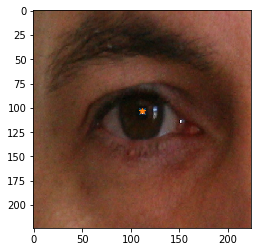

(110.810097,106.855476) - (112.974753,107.091109)(gt): 2.177443


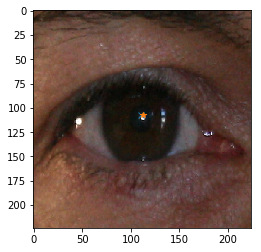

(105.831642,106.605751) - (105.842505,107.641366)(gt): 1.035672


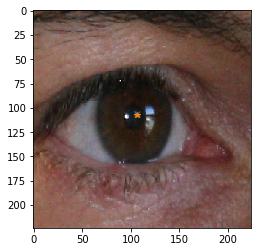

(100.897018,116.294479) - (102.058252,117.005825)(gt): 1.361792


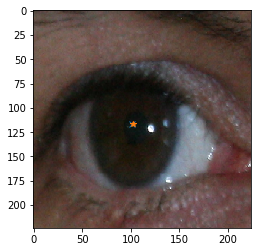

(118.392220,92.474617) - (120.073140,95.132409)(gt): 3.144734


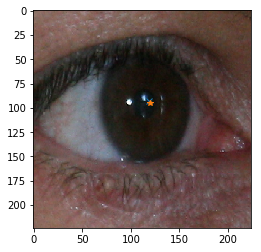

(115.001999,105.892921) - (111.545455,107.818182)(gt): 3.956555


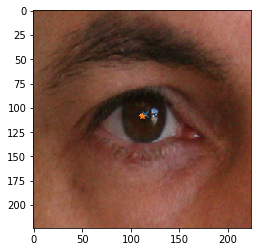

(108.998299,96.293793) - (108.933110,95.879599)(gt): 0.419293


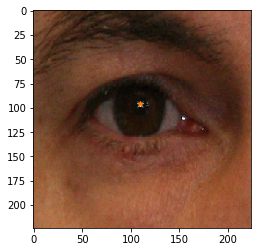

(102.856079,107.127663) - (103.211268,104.617371)(gt): 2.535296


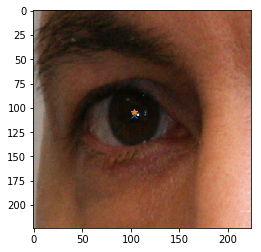

(108.155037,104.185059) - (108.445483,101.947040)(gt): 2.256786


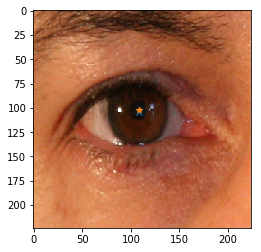

(110.482887,113.777344) - (108.952978,113.705329)(gt): 1.531603


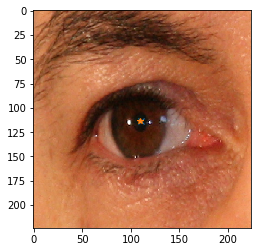

(106.938431,100.113564) - (105.860294,98.577206)(gt): 1.876905


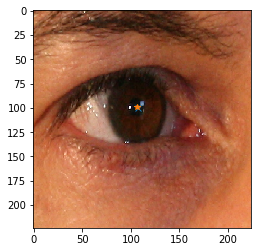

(120.490303,123.498482) - (121.791139,124.873418)(gt): 1.892782


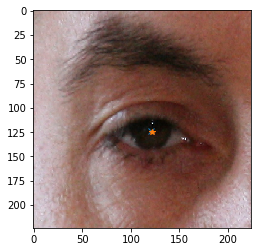

(106.306320,105.711517) - (105.961672,106.968641)(gt): 1.303512


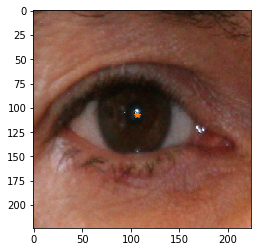

(90.987679,121.987373) - (87.907268,117.987469)(gt): 5.048581


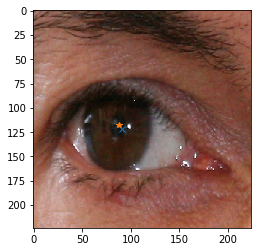

(111.353622,116.805542) - (114.317529,120.750000)(gt): 4.933912


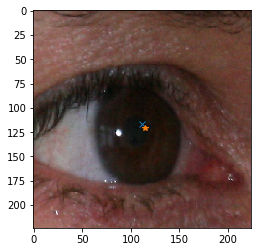

(95.699074,95.543030) - (94.922993,90.000000)(gt): 5.597096


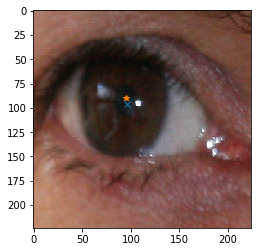

(100.541931,103.266060) - (102.000000,108.798995)(gt): 5.721830


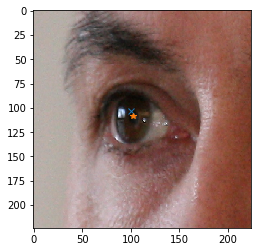

(109.170303,133.983017) - (106.497925,130.091286)(gt): 4.720929


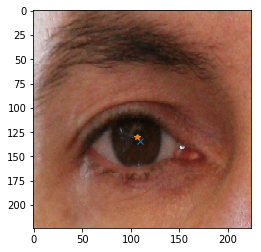

(113.022919,97.857239) - (113.913043,102.138340)(gt): 4.372659


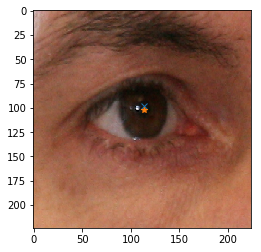

(127.684242,107.996452) - (126.479042,104.323353)(gt): 3.865768


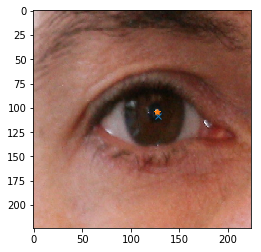

(120.176857,100.159775) - (122.997230,98.842105)(gt): 3.112998


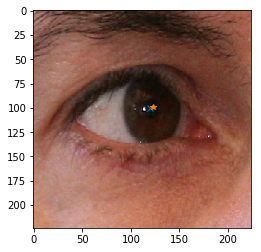

(113.446930,112.674393) - (113.861878,114.348066)(gt): 1.724345


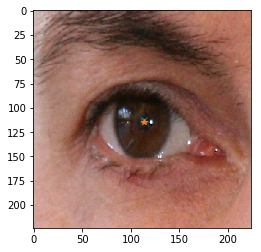

(111.589340,92.898773) - (112.614130,97.353261)(gt): 4.570848


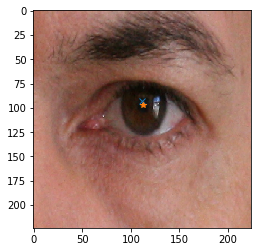

(107.113335,115.708260) - (108.570611,116.595420)(gt): 1.706079


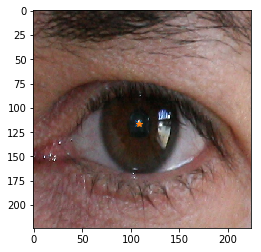

(121.032448,112.689819) - (119.943289,113.109641)(gt): 1.167269


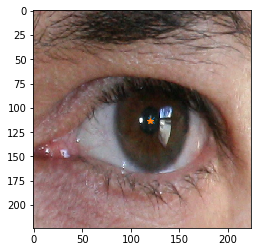

(100.677956,87.212318) - (102.921665,94.616891)(gt): 7.737049


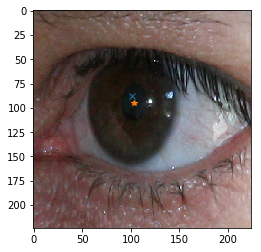

(118.165718,91.676964) - (118.401225,95.424196)(gt): 3.754626


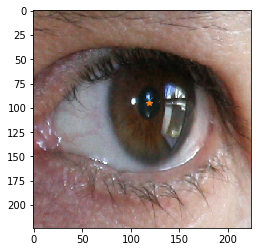

(116.800919,99.780838) - (116.422619,104.589286)(gt): 4.823306


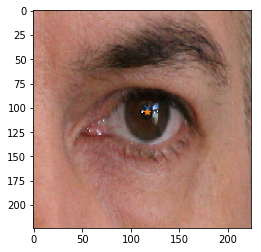

(114.068024,101.824974) - (114.238532,103.655963)(gt): 1.838911


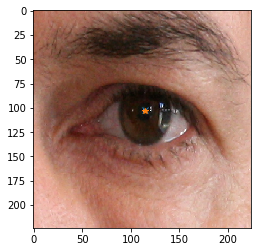

(113.323685,96.635361) - (115.235521,99.293436)(gt): 3.274215


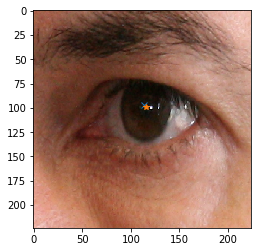

(113.429939,96.951462) - (115.996678,99.292359)(gt): 3.473895


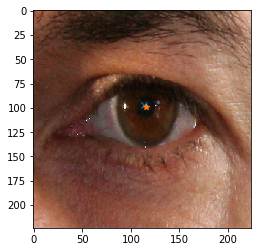

(112.335960,100.351868) - (112.587459,100.029703)(gt): 0.408707


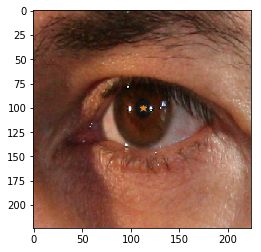

(117.852646,108.194481) - (115.992157,109.796078)(gt): 2.454900


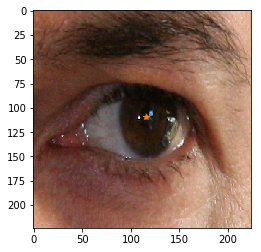

(108.071167,107.300018) - (111.972973,101.506757)(gt): 6.984695


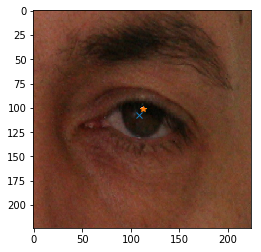

(117.291679,116.186195) - (122.140097,115.572464)(gt): 4.887107


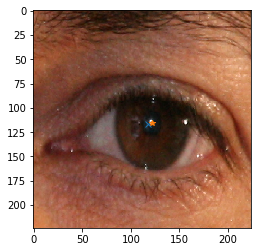

(108.320023,107.937119) - (106.988701,107.522599)(gt): 1.394362


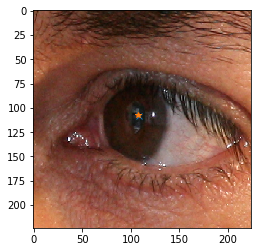

(116.469971,98.475586) - (117.615854,102.129573)(gt): 3.829448


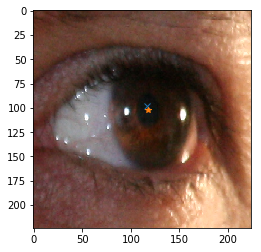

(80.654526,95.875420) - (79.950581,90.715116)(gt): 5.208096


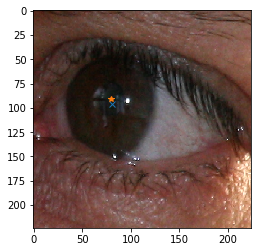

(100.033409,107.225517) - (107.520833,111.215278)(gt): 8.484086


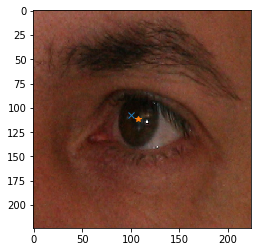

(106.879967,103.554504) - (112.250000,106.767045)(gt): 6.257610


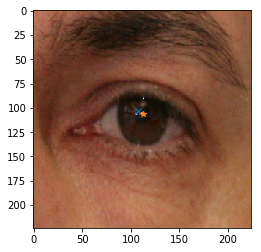

(111.980782,88.344307) - (117.200000,89.702326)(gt): 5.393001


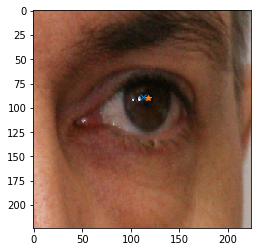

(109.567192,94.186554) - (110.382263,97.159021)(gt): 3.082191


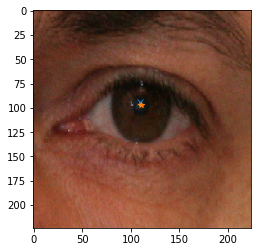

(136.119598,109.952324) - (132.092958,110.704225)(gt): 4.096241


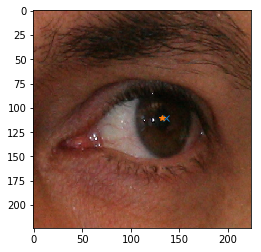

(96.695435,97.255440) - (100.672489,102.122271)(gt): 6.285142


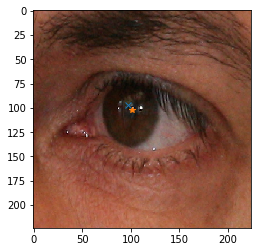

(111.377892,104.707825) - (116.065574,106.092896)(gt): 4.888025


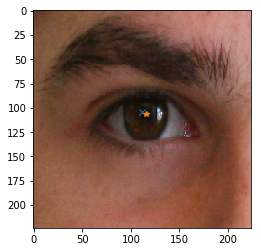

(102.582588,110.099617) - (102.483871,103.937788)(gt): 6.162620


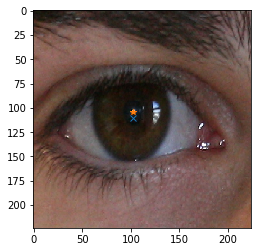

(117.804253,107.758827) - (116.876147,107.474771)(gt): 0.970602


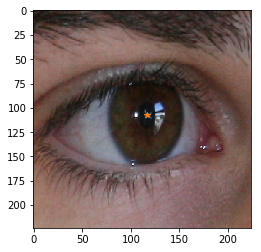

(95.960747,85.932396) - (95.938596,89.973684)(gt): 4.041349


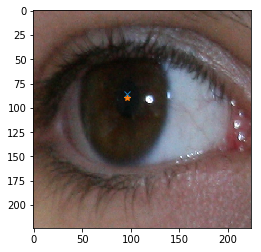

(119.422859,107.261543) - (118.081944,109.368056)(gt): 2.497088


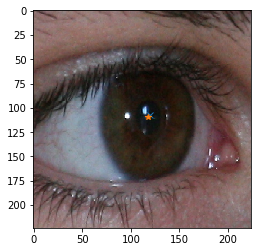

(112.599457,98.567238) - (113.155039,98.844961)(gt): 0.621129


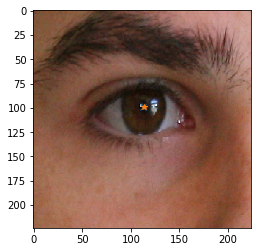

(109.478851,113.664680) - (107.191781,110.633562)(gt): 3.797153


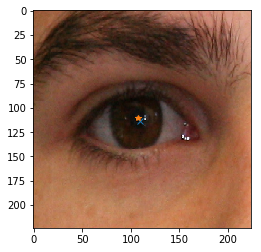

(105.425812,99.451881) - (107.056277,100.268398)(gt): 1.823490


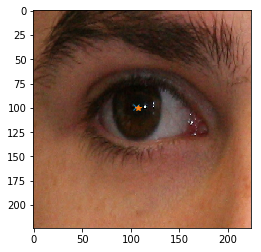

(108.714615,103.115570) - (110.036913,102.892617)(gt): 1.340962


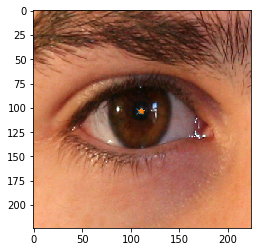

(105.943642,102.078072) - (104.120521,102.348534)(gt): 1.843073


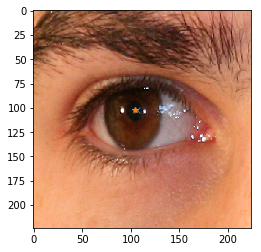

(111.180656,116.406380) - (112.830325,117.202166)(gt): 1.831579


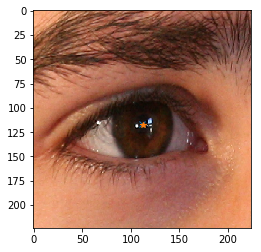

(110.717422,110.955643) - (106.272727,110.538961)(gt): 4.464184


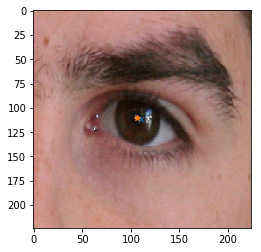

(116.977150,99.797302) - (111.787140,98.403548)(gt): 5.373896


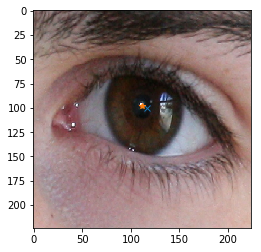

(104.568199,107.716942) - (102.147870,106.095238)(gt): 2.913403


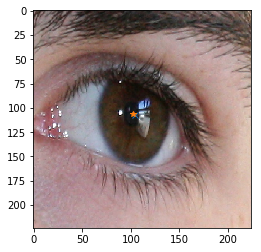

(107.948219,108.933258) - (106.883158,102.845263)(gt): 6.180456


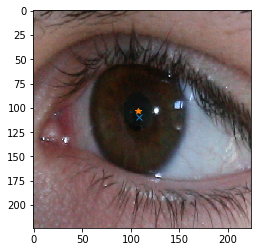

(117.162651,102.880432) - (116.605926,103.405926)(gt): 0.765563


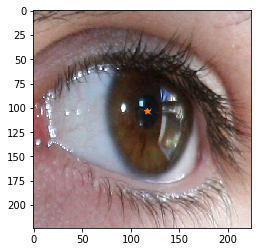

(114.472893,100.149094) - (107.443243,99.183784)(gt): 7.095618


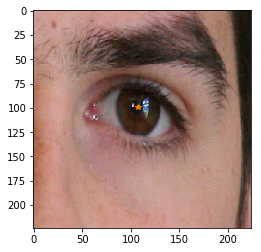

(110.517441,105.169212) - (108.008929,102.000000)(gt): 4.041849


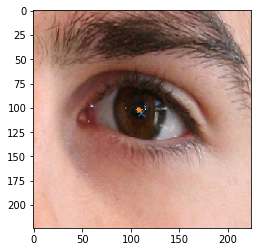

(108.896255,103.940758) - (108.628159,101.765343)(gt): 2.191873


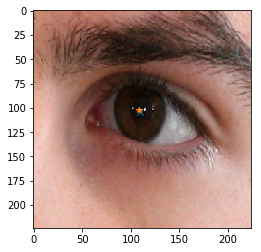

(110.909843,110.539963) - (108.701863,110.338509)(gt): 2.217151


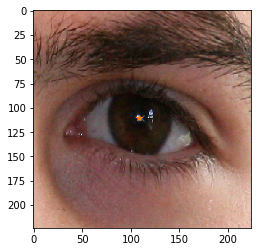

(105.066994,104.184578) - (108.462783,103.498382)(gt): 3.464427


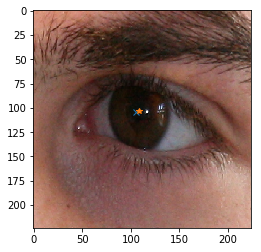

(109.257065,108.201843) - (103.164706,102.247059)(gt): 8.519172


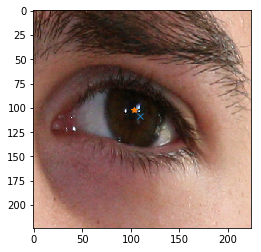

(108.929901,99.704079) - (110.988764,100.814607)(gt): 2.339271


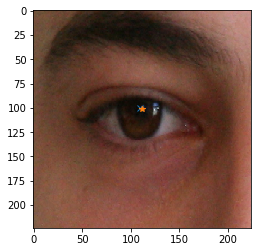

(119.491562,106.534828) - (117.012097,102.155242)(gt): 5.032745


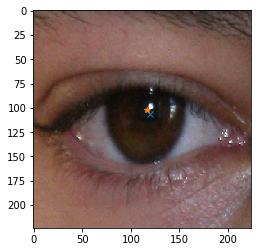

(121.200729,115.712914) - (121.339286,104.048214)(gt): 11.665522


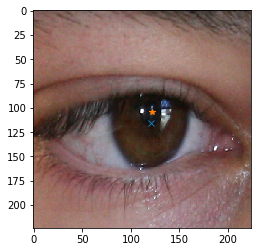

(98.261589,102.770088) - (102.694878,104.734967)(gt): 4.849205


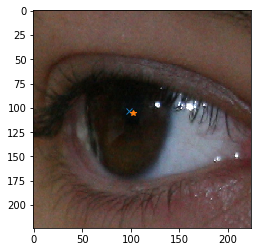

(129.431366,106.126228) - (134.161103,99.708273)(gt): 7.972488


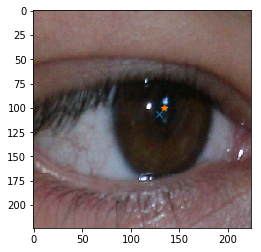

(104.335701,113.749413) - (102.916168,111.532934)(gt): 2.632081


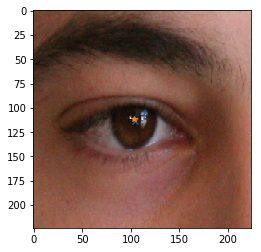

(111.617783,106.836571) - (113.694779,104.742972)(gt): 2.949080


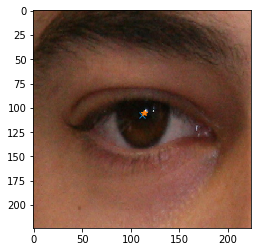

(111.400551,111.548897) - (107.085603,109.933852)(gt): 4.607292


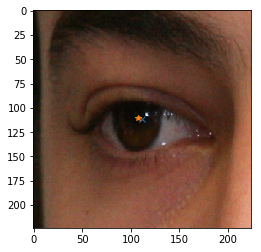

(116.869820,118.940048) - (119.680702,110.835088)(gt): 8.578546


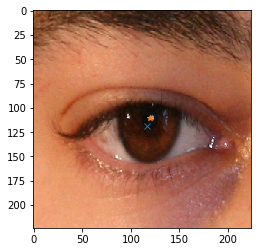

(108.477142,99.143242) - (107.185874,95.427509)(gt): 3.933706


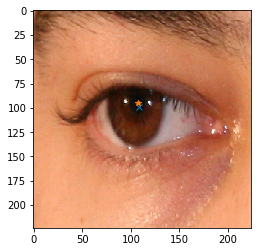

(112.090752,126.270813) - (113.196891,121.243523)(gt): 5.147542


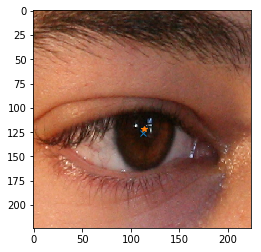

(97.696671,104.496178) - (103.472603,105.541096)(gt): 5.869689


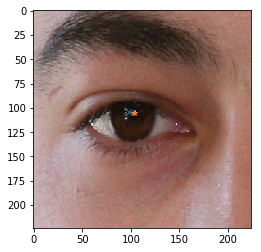

(111.742340,93.562775) - (112.351010,89.896465)(gt): 3.716491


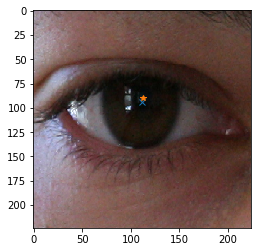

(78.614098,86.509384) - (76.375000,77.304054)(gt): 9.473735


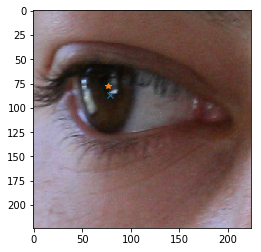

(114.871445,107.488777) - (112.689349,97.112426)(gt): 10.603311


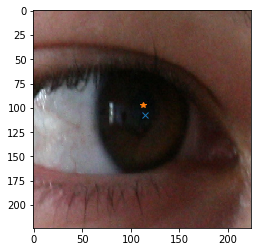

(97.703026,90.189407) - (96.862338,89.794805)(gt): 0.928691


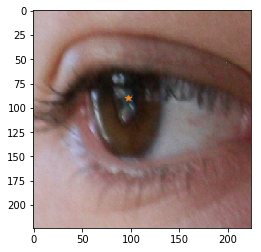

(99.652817,107.270226) - (100.307692,109.663462)(gt): 2.481218


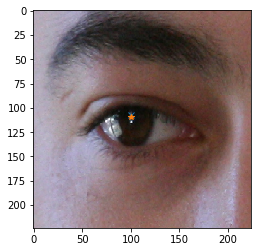

(102.675507,112.870026) - (105.084112,109.014019)(gt): 4.546446


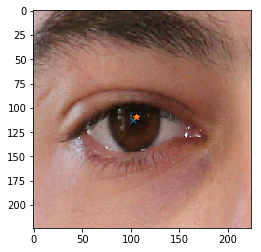

(124.006729,113.950783) - (125.202429,111.595142)(gt): 2.641731


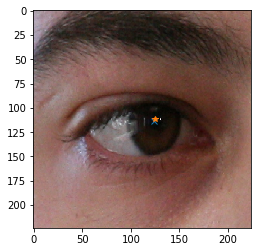

(108.803009,103.977058) - (107.670927,100.568690)(gt): 3.591460


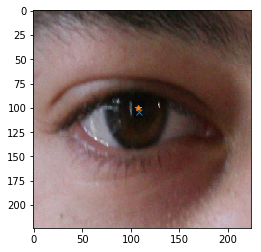

(118.310959,111.346146) - (115.314985,107.058104)(gt): 5.230981


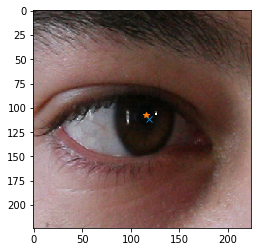

(94.037407,103.663773) - (95.422857,100.565714)(gt): 3.393735


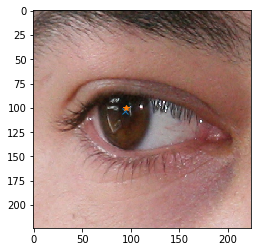

(111.622803,109.544426) - (112.767956,106.850829)(gt): 2.926917


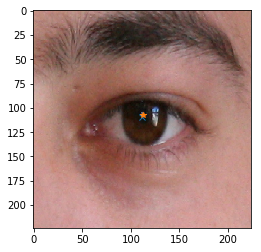

(110.939552,107.316597) - (112.320641,101.685371)(gt): 5.798113


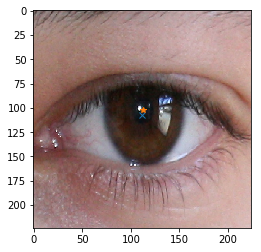

(111.239456,111.027290) - (114.792105,105.976316)(gt): 6.175246


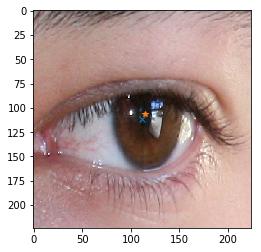

(106.889496,113.711388) - (106.175691,107.754696)(gt): 5.999308


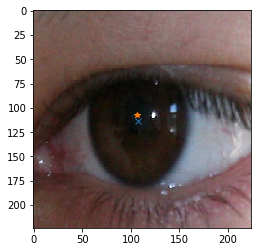

(132.550201,104.282753) - (136.312112,96.562112)(gt): 8.588380


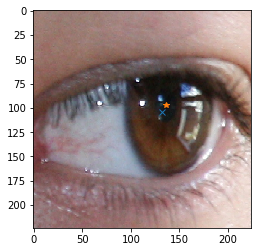

(105.174393,101.223457) - (102.202703,97.378378)(gt): 4.859586


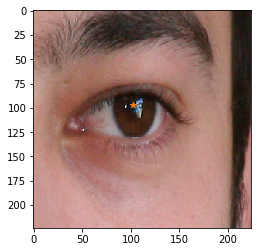

(109.391029,103.526314) - (106.601695,97.652542)(gt): 6.502429


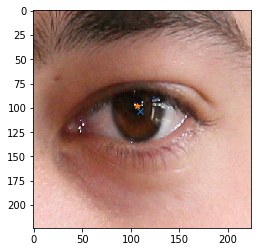

(107.217178,101.702713) - (105.928571,101.485714)(gt): 1.306750


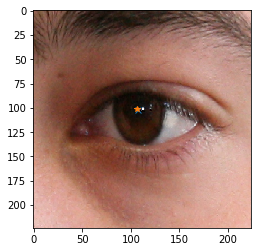

(103.899857,102.458809) - (107.470588,102.211765)(gt): 3.579267


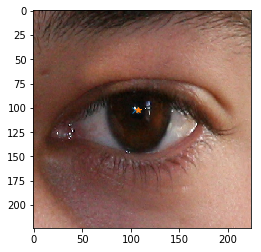

(107.034653,103.333931) - (106.821429,100.324675)(gt): 3.016800


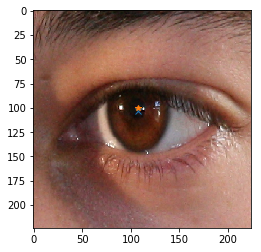

(115.095421,100.987534) - (114.920792,95.500000)(gt): 5.490311


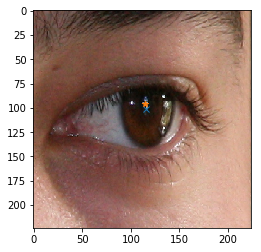

(110.618362,115.014603) - (113.432000,115.016000)(gt): 2.813638


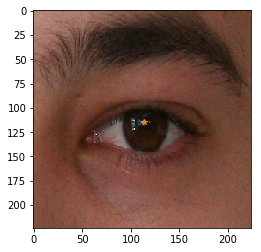

(93.832031,104.545891) - (81.404598,99.140230)(gt): 13.552206


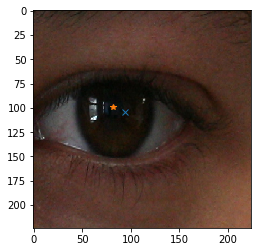

(99.932053,101.159111) - (106.671024,100.385621)(gt): 6.783216


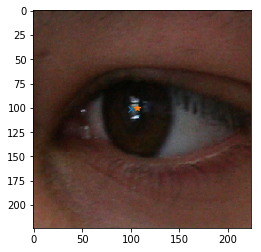

(113.404373,101.855438) - (114.815789,99.228070)(gt): 2.982475


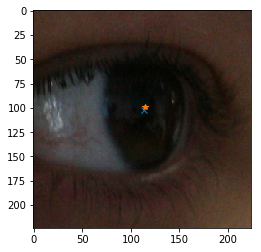

(90.086441,95.098923) - (102.059871,83.940129)(gt): 16.367091


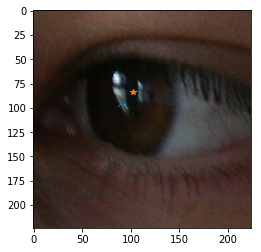

(105.146530,119.746460) - (110.030534,121.534351)(gt): 5.200966


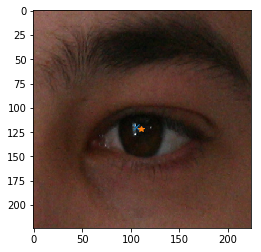

(79.058876,123.439018) - (71.130435,129.695652)(gt): 10.099785


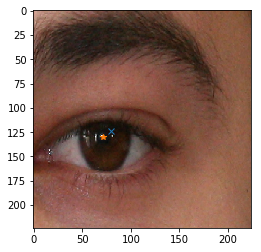

(115.600540,124.397774) - (122.349693,121.466258)(gt): 7.358319


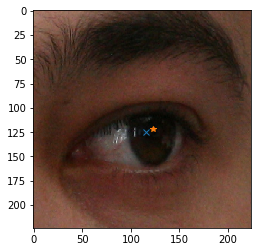

(112.074593,102.046646) - (113.976261,100.643917)(gt): 2.363047


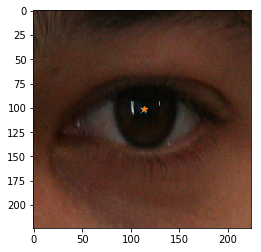

(114.758141,105.789856) - (117.853526,107.258590)(gt): 3.426163


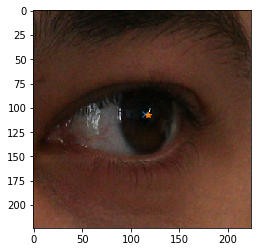

(82.837746,124.936317) - (84.121547,123.110497)(gt): 2.231987


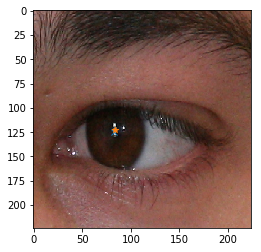

(115.305824,110.907204) - (114.251572,103.031447)(gt): 7.946005


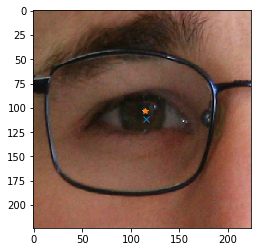

(102.433578,97.656822) - (106.514523,103.672199)(gt): 7.269035


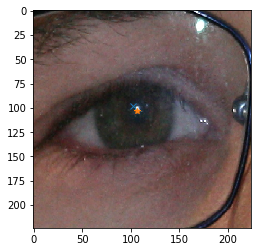

(103.329300,110.465591) - (102.507640,119.899830)(gt): 9.469952


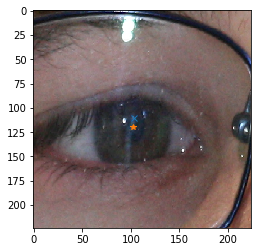

(106.942551,104.672806) - (112.951302,110.371461)(gt): 8.281290


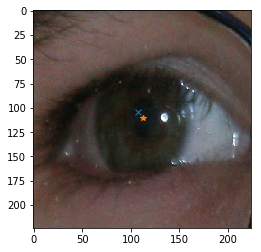

(104.469704,100.640060) - (109.185699,105.565635)(gt): 6.819230


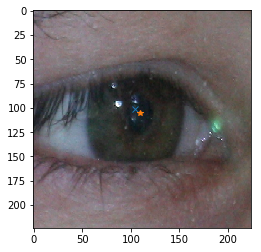

(122.432533,106.800484) - (114.110236,103.803150)(gt): 8.845600


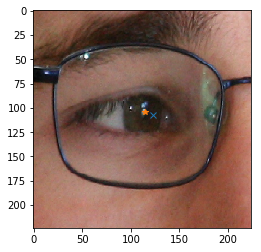

(113.583496,99.266830) - (117.399160,98.970588)(gt): 3.827146


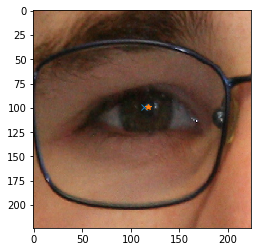

(116.187561,119.861435) - (106.376426,108.228137)(gt): 15.218147


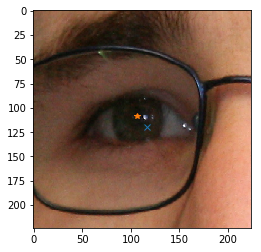

(110.175270,104.694893) - (104.241379,110.462069)(gt): 8.274743


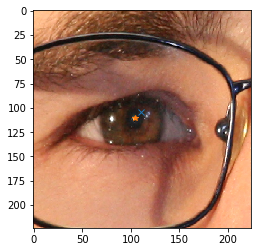

(120.599525,106.213081) - (111.865546,103.676471)(gt): 9.094877


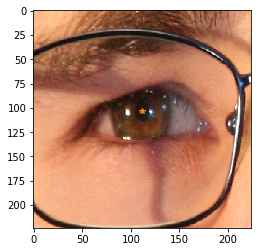

(122.776062,111.771896) - (120.265152,113.939394)(gt): 3.317034


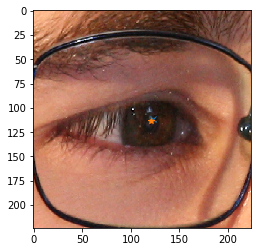

(123.563248,131.425125) - (119.036810,125.276074)(gt): 7.635409


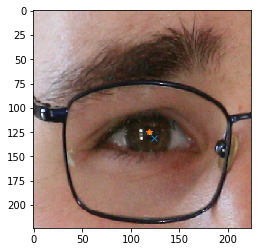

(95.253624,97.440987) - (92.002137,105.104701)(gt): 8.324944


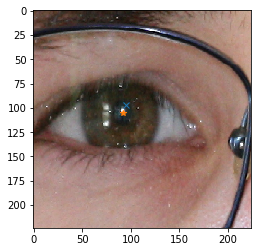

(91.805977,113.096497) - (83.927052,120.039514)(gt): 10.501569


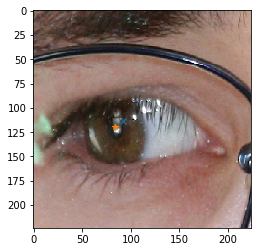

(119.857246,90.353729) - (136.448366,92.339869)(gt): 16.709578


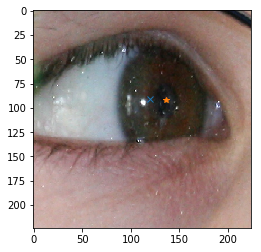

(98.357460,90.810524) - (95.004202,100.162465)(gt): 9.934945


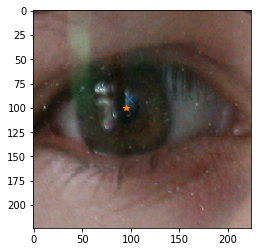

(112.708519,113.861893) - (101.137931,98.114943)(gt): 19.540853


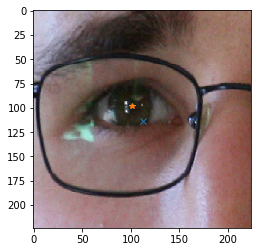

(114.958923,109.944893) - (105.086957,103.722826)(gt): 11.669184


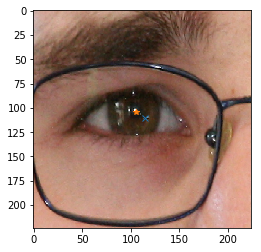

(129.758194,105.774933) - (126.721698,108.476415)(gt): 4.064273


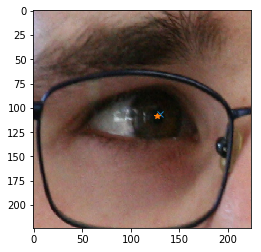

(121.457489,107.397736) - (113.634146,113.556911)(gt): 9.956914


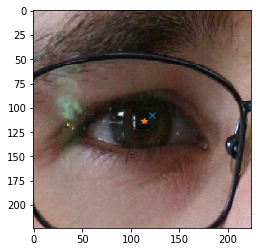

(125.336540,109.112854) - (117.893836,109.955479)(gt): 7.490252


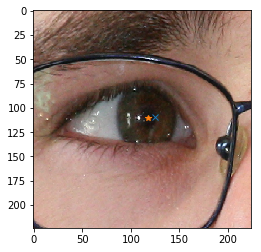

(105.204834,112.504440) - (96.370213,118.885106)(gt): 10.897864


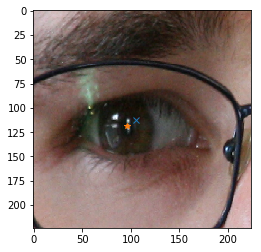

(110.805786,108.505745) - (104.073620,110.717791)(gt): 7.086269


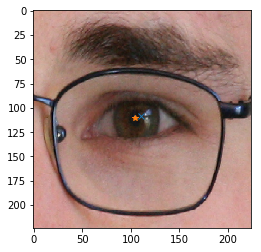

(109.957291,111.729332) - (111.754797,119.204691)(gt): 7.688434


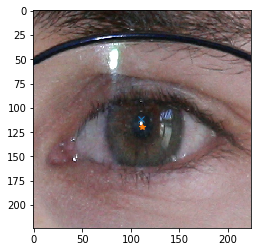

(92.283051,94.172371) - (100.650235,101.403756)(gt): 11.059055


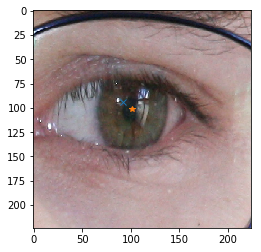

(99.843651,97.816299) - (104.551559,102.806954)(gt): 6.860833


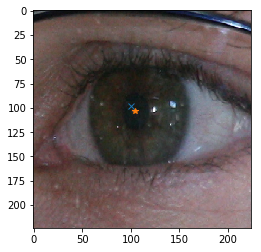

(103.649643,107.267014) - (108.163531,109.085384)(gt): 4.866380


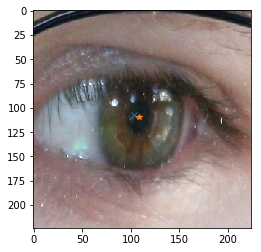

(104.877922,99.842384) - (117.465116,113.732558)(gt): 18.744983


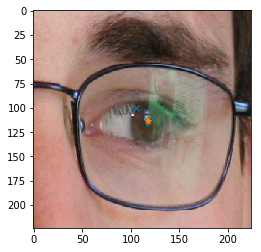

(114.441505,107.825005) - (111.442149,111.326446)(gt): 4.610448


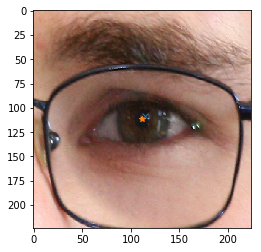

(100.452866,113.258377) - (98.814815,117.763889)(gt): 4.794043


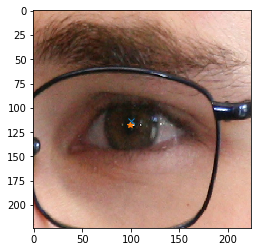

(101.483139,92.199348) - (99.285714,103.200680)(gt): 11.218644


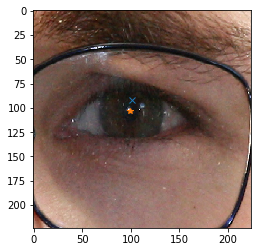

(98.319473,90.498329) - (102.051136,102.872159)(gt): 12.924279


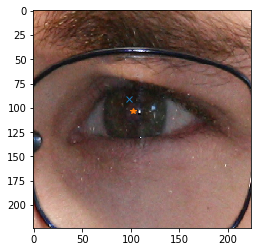

(108.952072,98.679657) - (110.427419,101.979839)(gt): 3.614948


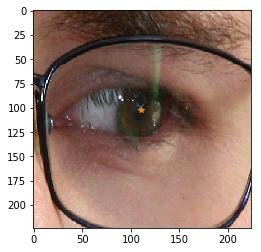

(102.341286,105.931892) - (138.255319,87.122340)(gt): 40.541547


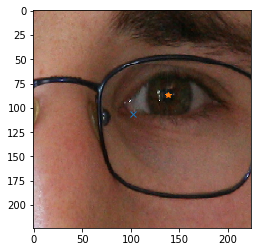

(105.143814,92.658470) - (102.744035,90.401302)(gt): 3.294503


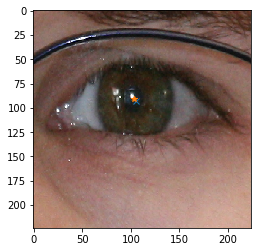

(100.377243,108.550827) - (94.543641,116.461347)(gt): 9.828898


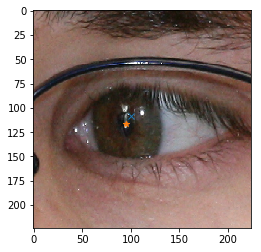

(131.142578,112.089767) - (122.009296,114.256308)(gt): 9.386732


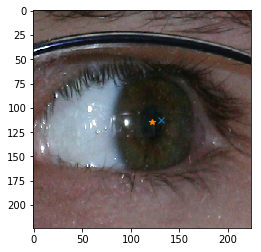

(93.673500,115.281296) - (92.004678,117.963743)(gt): 3.159191


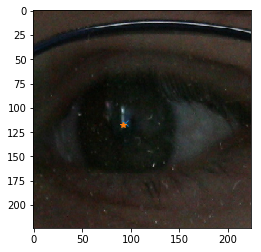

(111.722931,113.150703) - (111.767742,124.064516)(gt): 10.913905


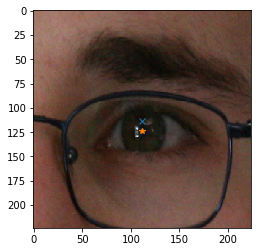

(122.508926,121.340263) - (112.315000,130.100000)(gt): 13.440577


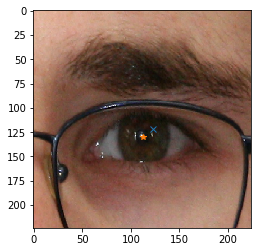

(112.752800,96.518700) - (103.838565,101.264574)(gt): 10.098857


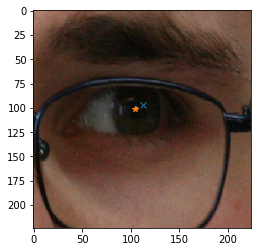

(119.013824,109.687294) - (109.091205,114.495114)(gt): 11.026038


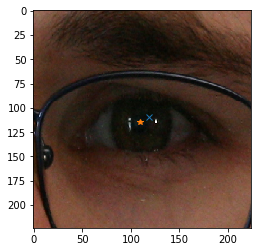

(118.399391,97.820061) - (106.748447,108.760870)(gt): 15.982672


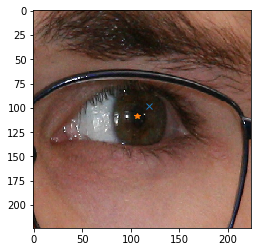

(93.937729,105.839561) - (78.333333,118.287879)(gt): 19.961407


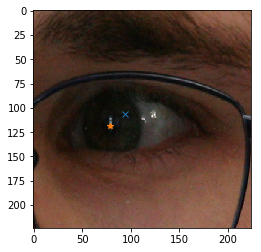

(106.995087,98.362724) - (104.675325,97.272727)(gt): 2.563082


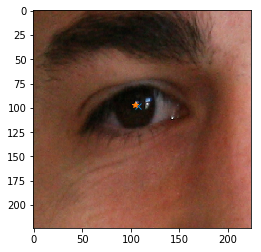

(107.865387,108.343430) - (108.099125,106.119534)(gt): 2.236146


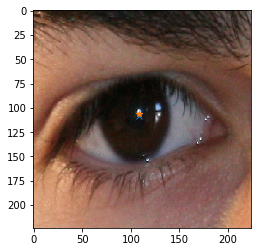

(122.562187,109.381317) - (115.779817,104.006881)(gt): 8.653619


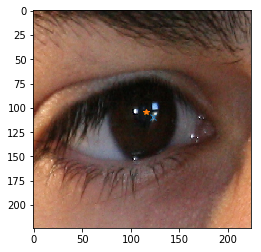

(90.568871,105.571869) - (80.674938,105.617866)(gt): 9.894039


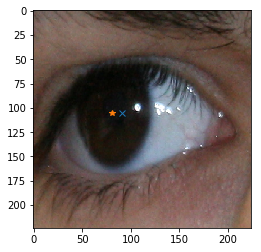

(126.127396,87.482582) - (119.827633,88.190150)(gt): 6.339374


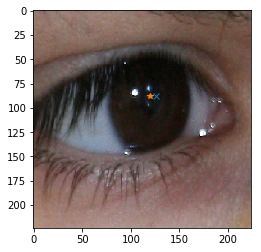

(111.862473,112.840469) - (108.471591,109.090909)(gt): 5.055421


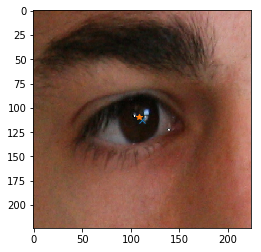

(111.172684,111.685547) - (112.920354,109.438053)(gt): 2.847030


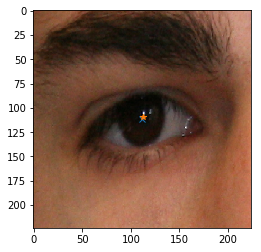

(112.084839,112.667366) - (109.100000,110.868750)(gt): 3.484865


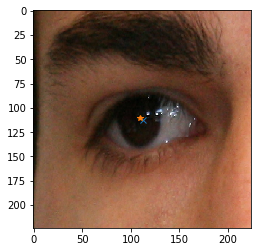

(117.663353,115.167084) - (113.323077,115.530769)(gt): 4.355487


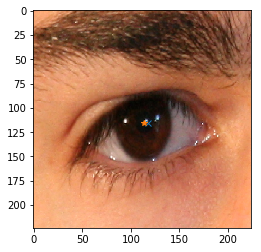

(114.768326,109.152779) - (107.872340,105.736170)(gt): 7.695962


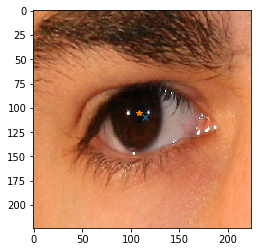

(111.222534,106.653801) - (111.210280,113.067757)(gt): 6.413968


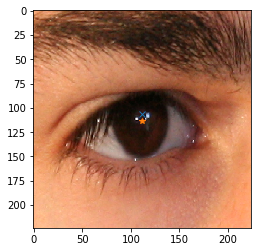

(95.624557,94.004082) - (98.471204,97.895288)(gt): 4.821295


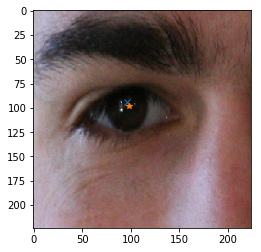

(109.580536,103.546677) - (108.948905,100.289538)(gt): 3.317817


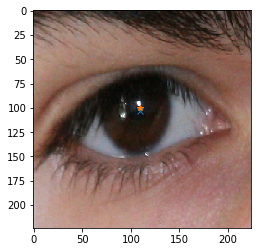

(99.626862,98.301483) - (96.532164,94.715400)(gt): 4.736787


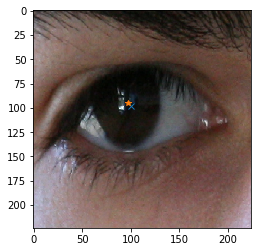

(118.701408,107.428848) - (120.727124,104.555556)(gt): 3.515585


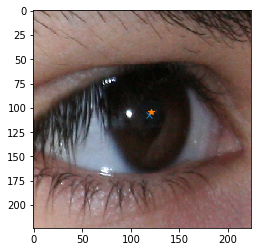

(102.172272,100.919380) - (100.225266,98.627093)(gt): 3.007559


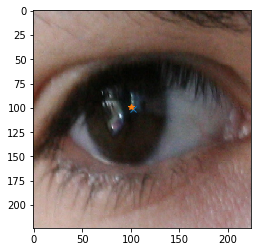

(105.160767,108.940727) - (109.167742,101.238710)(gt): 8.681989


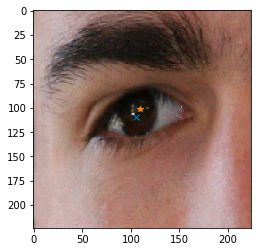

(108.332916,123.603325) - (107.528846,121.014423)(gt): 2.710893


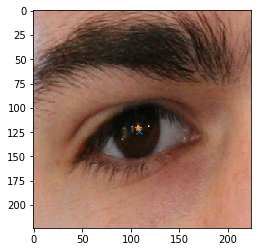

(104.953583,103.024788) - (101.856618,105.419118)(gt): 3.914589


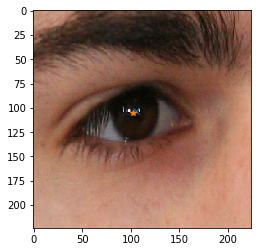

(99.580734,102.797676) - (99.530488,102.676829)(gt): 0.130877


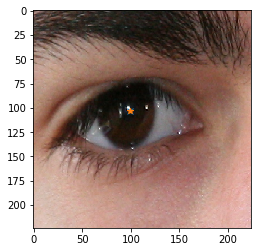

(120.499336,100.880142) - (116.844221,100.027638)(gt): 3.753216


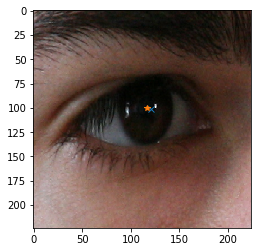

(104.547920,93.952271) - (104.529545,96.352273)(gt): 2.400073


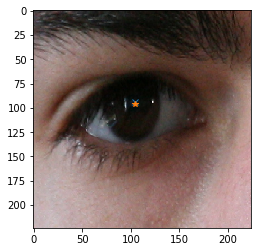

(111.040901,114.077705) - (105.654762,109.162698)(gt): 7.291625


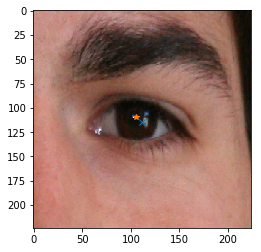

(107.178635,115.126801) - (100.354023,113.721839)(gt): 6.967729


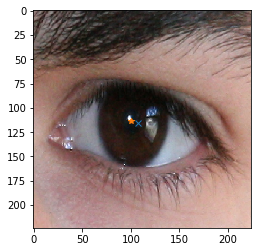

(121.061180,101.301048) - (116.238213,101.004963)(gt): 4.832047


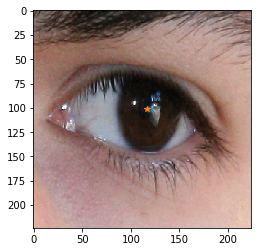

(102.677635,94.694733) - (98.321346,98.997680)(gt): 6.123121


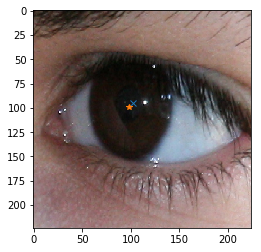

(113.221893,103.816338) - (112.308426,100.562798)(gt): 3.379340


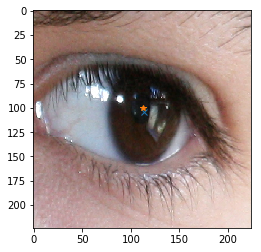

(116.368706,106.987335) - (104.056075,102.028037)(gt): 13.273866


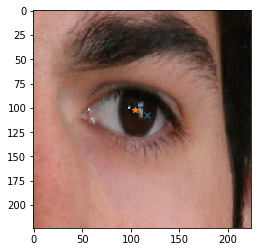

(112.759499,114.592979) - (107.355072,107.654589)(gt): 8.794832


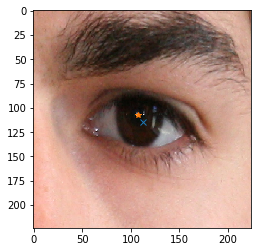

(108.101570,111.873657) - (108.246241,109.531955)(gt): 2.346167


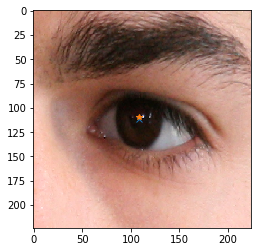

(113.354179,108.269722) - (109.595782,111.446397)(gt): 4.921058


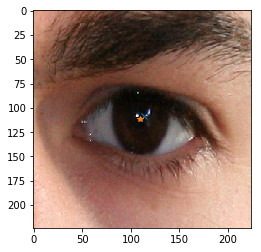

(115.552307,103.350113) - (114.296524,104.398773)(gt): 1.636056


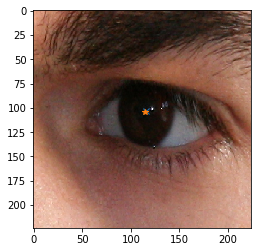

(116.486900,110.040794) - (107.373162,99.750000)(gt): 13.746297


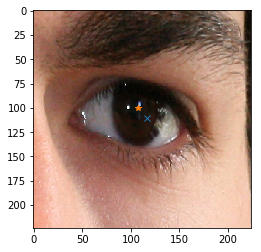

(93.943993,94.607986) - (92.473684,103.218045)(gt): 8.734696


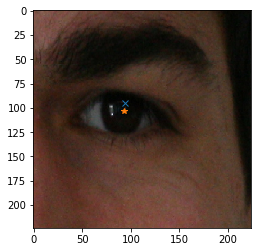

(106.937508,102.061371) - (103.021448,99.554960)(gt): 4.649475


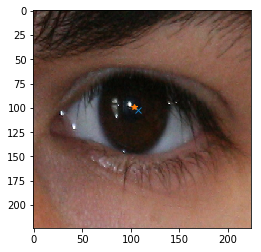

(107.400421,101.370094) - (106.552538,97.696576)(gt): 3.770098


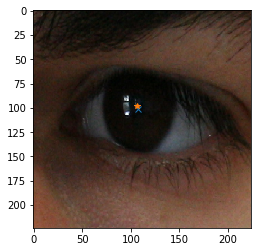

(130.379837,105.940857) - (128.354839,108.712067)(gt): 3.432233


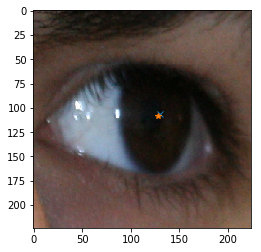

(96.785622,115.598999) - (102.814575,101.879352)(gt): 14.985893


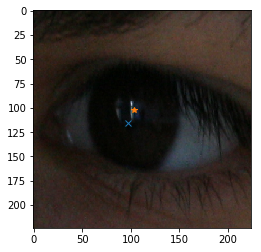

(124.601509,102.836266) - (133.346561,105.611111)(gt): 9.174731


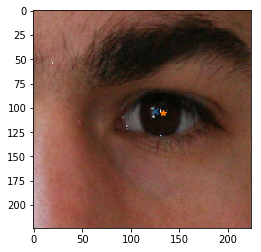

(120.132439,90.679771) - (120.732432,92.945946)(gt): 2.344257


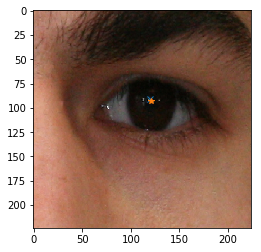

(124.046860,98.756966) - (123.638191,100.040201)(gt): 1.346738


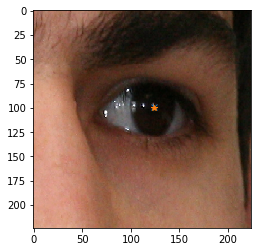

(117.609024,111.107674) - (115.053512,106.234114)(gt): 5.502929


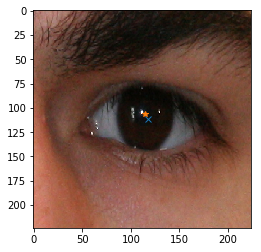

(123.610710,106.048744) - (118.018692,101.611215)(gt): 7.138791


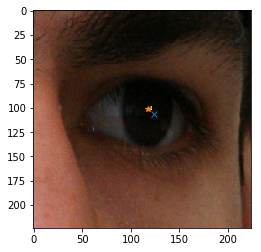

(114.616173,112.426437) - (109.877717,110.216033)(gt): 5.228657


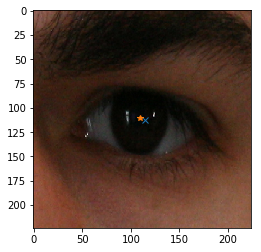

(103.426849,97.917610) - (109.220651,100.386139)(gt): 6.297759


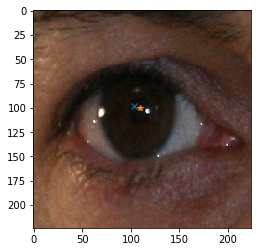

(106.099724,107.582420) - (107.280000,108.122222)(gt): 1.297859


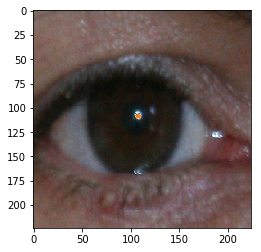

(112.598488,108.574234) - (113.256809,108.727626)(gt): 0.675956


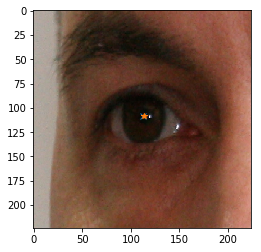

(115.843155,108.595612) - (113.320312,110.746094)(gt): 3.315012


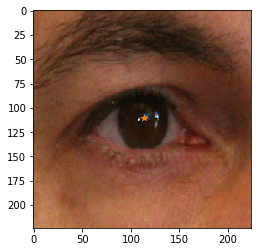

(116.933578,108.178978) - (123.029549,110.477449)(gt): 6.514893


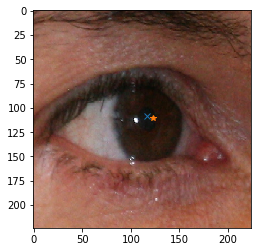

(117.519371,119.390305) - (116.800414,121.154085)(gt): 1.904684


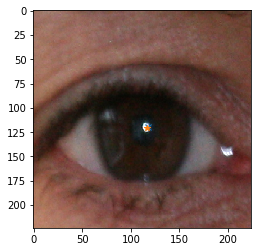

(105.209084,109.946007) - (102.196850,111.976378)(gt): 3.632624


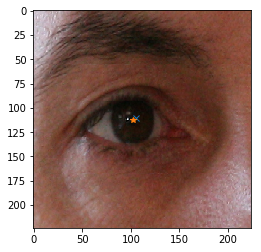

(104.132355,119.142303) - (102.422680,119.422680)(gt): 1.732512


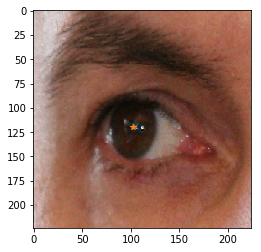

(98.546043,92.790337) - (102.506770,99.137331)(gt): 7.481423


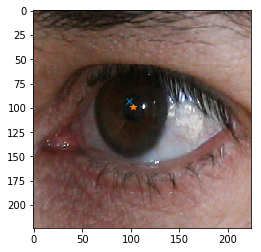

(116.005241,93.441643) - (112.284605,96.359638)(gt): 4.728406


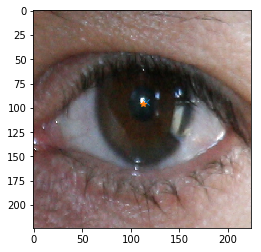

(103.066711,87.871521) - (109.356322,94.045977)(gt): 8.813802


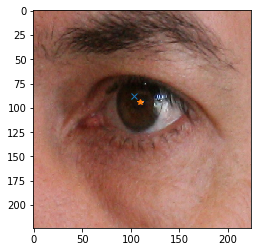

(115.365669,107.764610) - (113.557143,110.452381)(gt): 3.239580


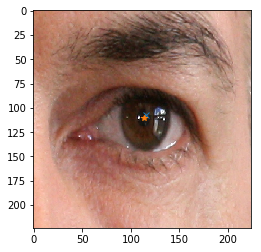

(110.624687,101.473579) - (107.529703,103.990099)(gt): 3.988960


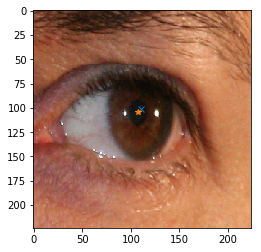

(109.833290,101.039131) - (114.056225,98.847390)(gt): 4.757826


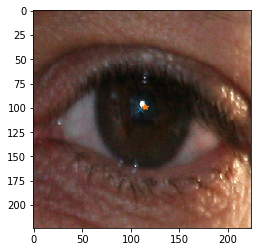

(101.403542,115.432182) - (100.804688,115.023438)(gt): 0.725051


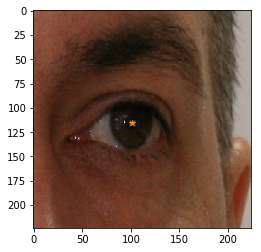

(82.442894,106.486519) - (88.260563,108.739437)(gt): 6.238663


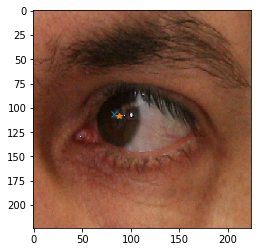

(91.070435,85.124901) - (92.798054,81.812652)(gt): 3.735727


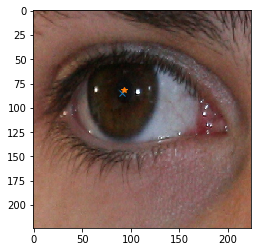

(116.050621,95.606956) - (109.455021,95.127615)(gt): 6.612995


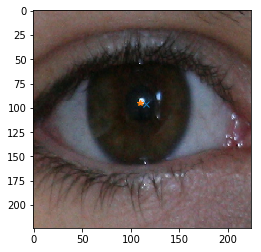

(106.004684,97.686417) - (109.686275,100.692810)(gt): 4.753158


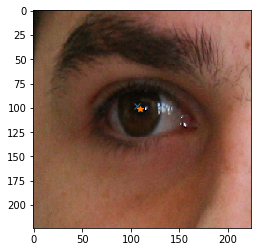

(116.722527,112.132751) - (113.023697,110.113744)(gt): 4.213993


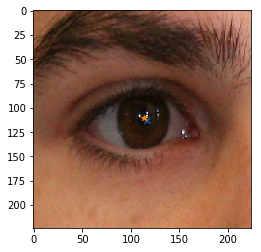

(106.006767,92.396049) - (103.765237,88.462754)(gt): 4.527170


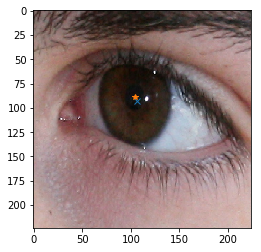

(102.753204,112.001312) - (101.019192,107.475758)(gt): 4.846385


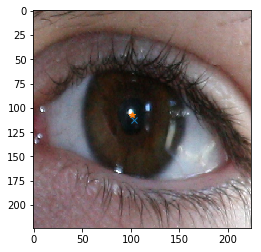

(114.926682,106.521172) - (111.568306,111.207650)(gt): 5.765568


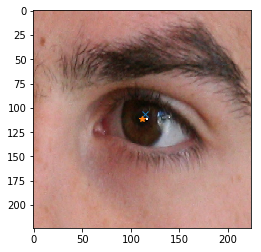

(111.828529,115.821281) - (105.763636,108.127273)(gt): 9.796974


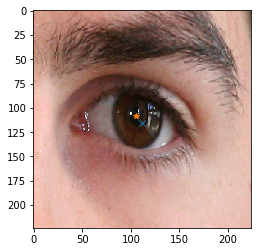

(108.710426,115.815750) - (111.778646,116.359375)(gt): 3.116007


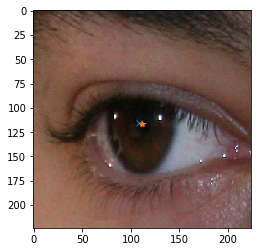

(113.108459,113.562920) - (115.556948,107.312073)(gt): 6.713284


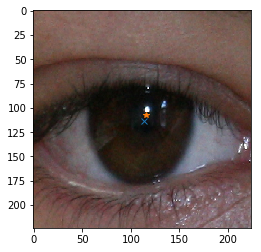

(111.715630,98.561676) - (108.683544,99.234177)(gt): 3.105769


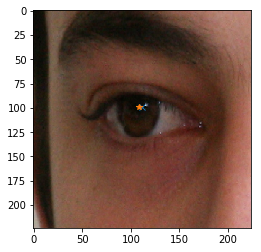

(109.431549,104.704994) - (106.180995,97.823529)(gt): 7.610562


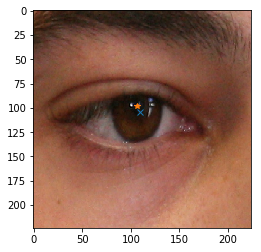

(125.476349,101.539719) - (121.248421,99.120000)(gt): 4.871387


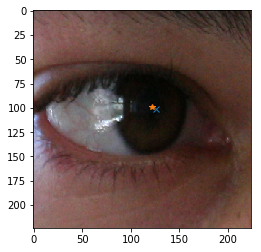

(92.295250,93.346390) - (86.382824,78.333333)(gt): 16.135323


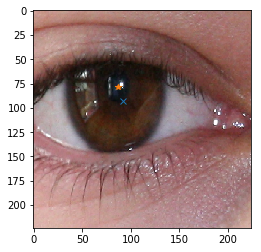

(101.057549,101.803970) - (107.248447,106.018634)(gt): 7.489367


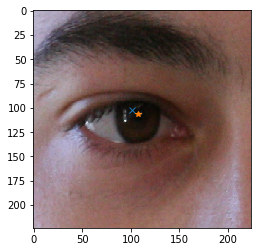

(118.035393,127.659729) - (121.671717,116.429293)(gt): 11.804472


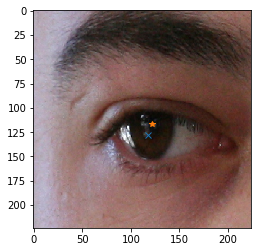

(110.674713,105.629150) - (112.631970,102.204461)(gt): 3.944535


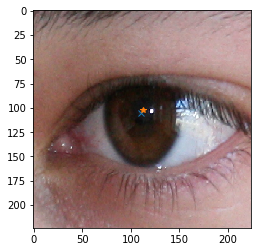

(107.631790,101.714645) - (103.300099,96.914116)(gt): 6.465959


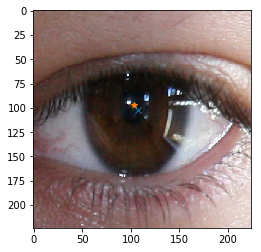

(105.830971,106.657883) - (111.196429,106.446429)(gt): 5.369623


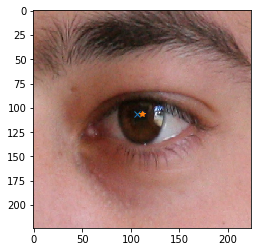

(109.734276,105.232162) - (109.801370,100.376712)(gt): 4.855914


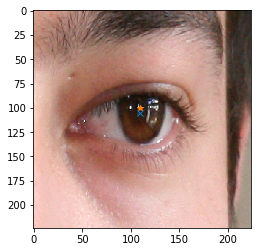

(135.634354,103.553719) - (147.383948,102.258134)(gt): 11.820808


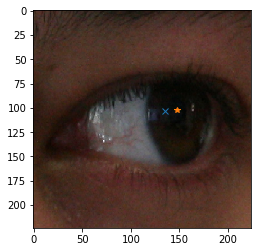

(123.237206,86.963089) - (125.927126,83.225371)(gt): 4.605019


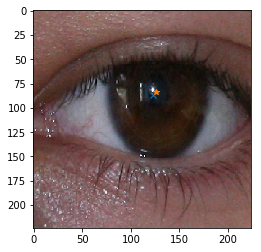

(107.547722,106.395500) - (110.400000,105.507143)(gt): 2.987419


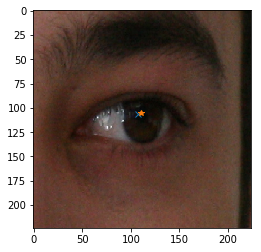

(93.624306,105.843323) - (95.372671,104.260870)(gt): 2.358164


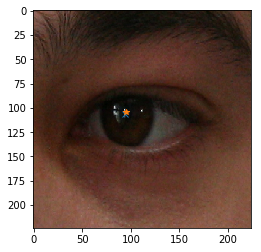

(107.100517,97.265045) - (107.190871,102.821577)(gt): 5.557266


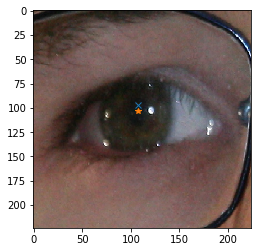

(107.788734,101.326698) - (110.800235,101.280846)(gt): 3.011850


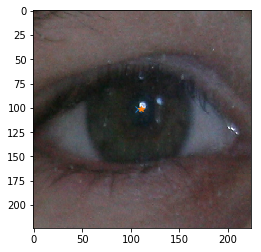

(110.702682,116.239174) - (109.479042,112.305389)(gt): 4.119704


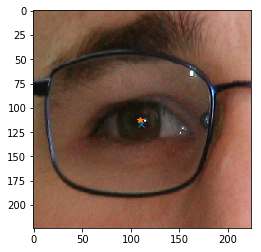

(107.338821,104.305710) - (100.789720,102.261682)(gt): 6.860669


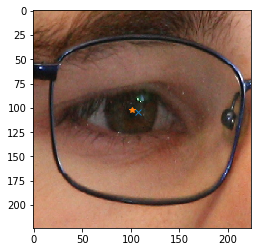

(144.048264,116.818878) - (135.345622,124.301843)(gt): 11.477401


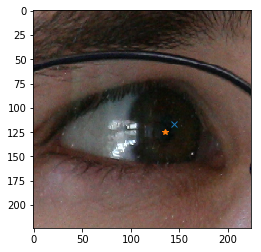

(100.180161,82.092903) - (105.040616,82.471989)(gt): 4.875216


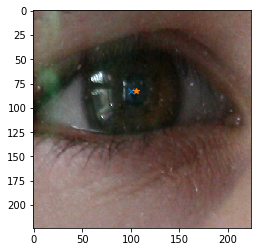

(117.895607,134.261841) - (114.053435,139.259542)(gt): 6.303912


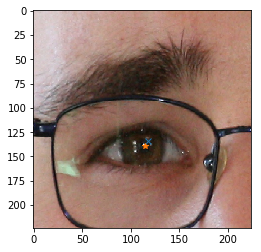

(110.070320,95.215683) - (99.725225,90.513514)(gt): 11.363599


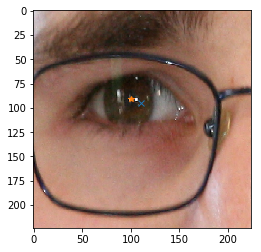

(100.159294,95.692528) - (98.086655,104.190641)(gt): 8.747215


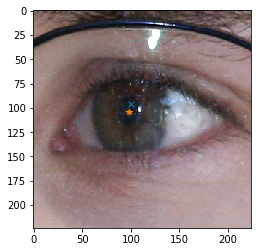

(113.365829,103.977730) - (113.412409,104.911192)(gt): 0.934624


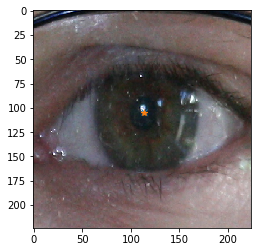

(106.561295,104.416313) - (103.398810,107.488095)(gt): 4.408759


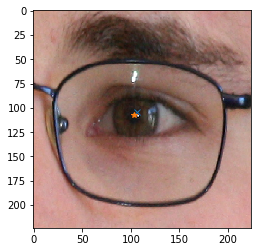

(96.271370,100.291588) - (101.058140,97.482558)(gt): 5.550118


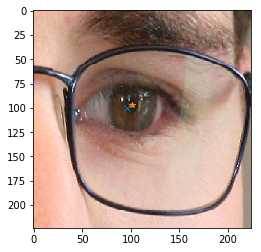

(129.537598,105.867508) - (116.251509,113.670020)(gt): 15.407769


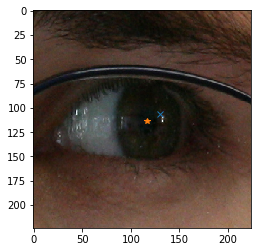

(108.054047,109.530876) - (115.923337,106.665163)(gt): 8.374846


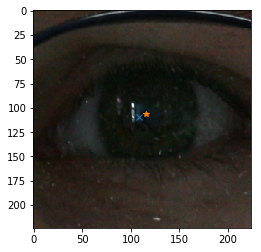

(105.269547,113.787422) - (94.465608,122.915344)(gt): 14.143692


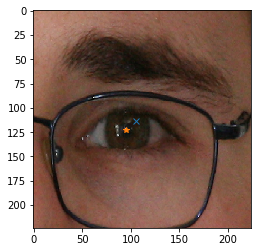

(109.193962,89.523750) - (102.449612,94.418605)(gt): 8.333418


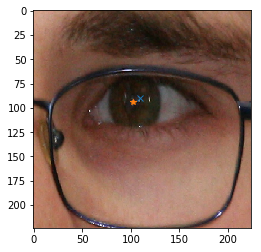

(106.982193,109.308960) - (105.464789,108.295775)(gt): 1.824571


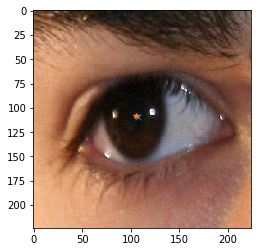

(118.036537,122.795998) - (115.790749,116.903084)(gt): 6.306346


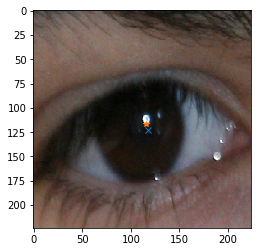

(112.473419,104.172638) - (110.373333,104.066667)(gt): 2.102758


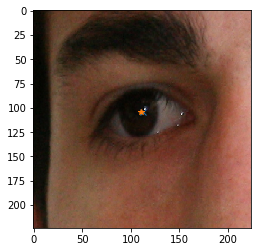

(111.390930,114.438774) - (109.255507,112.881057)(gt): 2.643202


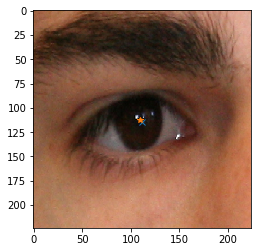

(121.797646,104.028625) - (118.518447,105.215534)(gt): 3.487391


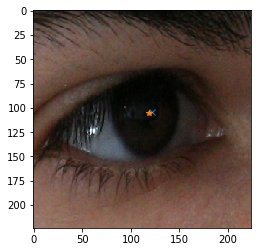

(96.630096,95.514572) - (94.434462,94.027982)(gt): 2.651558


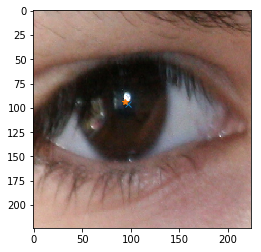

(105.219147,108.621681) - (113.932773,112.915966)(gt): 9.714328


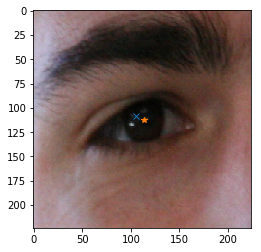

(98.347664,117.842346) - (91.414330,121.155763)(gt): 7.684390


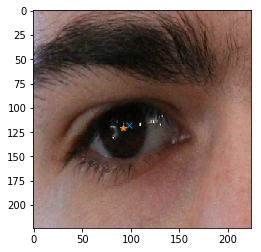

(94.678589,100.277100) - (95.055381,98.539185)(gt): 1.778291


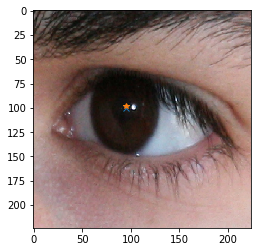

(104.947319,106.132217) - (97.776144,108.736928)(gt): 7.629566


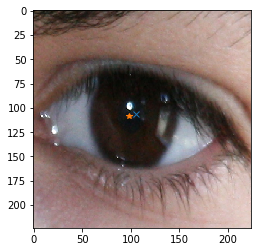

(102.982475,104.599678) - (102.032895,102.802632)(gt): 2.032506


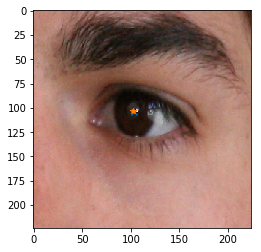

(112.312798,114.793083) - (105.822464,107.945652)(gt): 9.434604


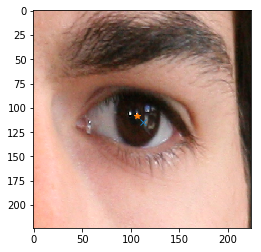

(114.071236,102.352196) - (105.266388,99.581590)(gt): 9.230471


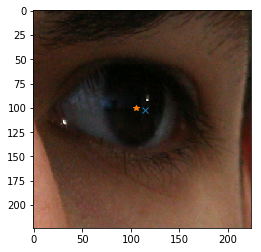

(126.748596,98.497292) - (123.885977,97.788952)(gt): 2.948954


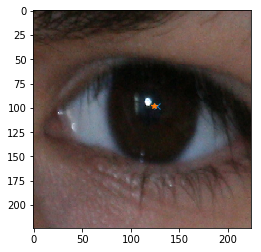

(108.266861,107.589417) - (118.638191,115.457286)(gt): 13.017982


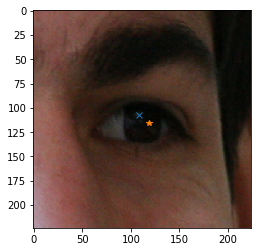

(104.409225,116.395966) - (102.669856,117.351675)(gt): 1.984637


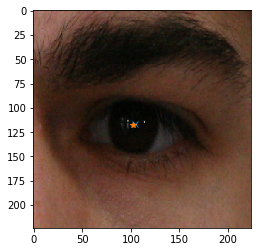

In [20]:
from PIL import Image
import matplotlib.pyplot as plt

n = 0

for i in range(len(fpaths_xs_test)):
    # テスト画像
    im1 = Image.open(fpaths_xs_test[i])
    im1 = im1.resize(target_size) 

    # Show pupil prediction
    print('(%f,%f) - (%f,%f)(gt): %f'%(outputs[i,0],outputs[i,1],
                                       center_test[i,0],center_test[i,1],
                                       np.linalg.norm(diff[i,:])))
    plt.imshow(im1)
    plt.plot(outputs[i,0], outputs[i,1],'x')
    plt.plot(center_test[i,0], center_test[i,1], '*')
    plt.show()

    n = n + 1

In [ ]:
#
#   Show History
#
if mode == "SHOW_HISTORY":
    # load pickle
    print(dname_checkpoints + '/' + fname_history)
    history = pickle.load(open(dname_checkpoints + '/' + fname_history, 'rb'))
    
    for k in history.keys():
        plt.plot(history[k])
        plt.title(k)
        plt.show()
